<a href="https://colab.research.google.com/github/YonggunJung/AI_Poly/blob/main/Lane_Detection_Development.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 차선 감지

In [ ]:
!git clone https://github.com/wwang/ML_CV_Teaching.git

Cloning into 'ML_CV_Teaching'...
remote: Enumerating objects: 168, done.
remote: Counting objects: 100% (58/58), done.
remote: Compressing objects: 100% (47/47), done.
remote: Total 168 (delta 20), reused 47 (delta 9), pack-reused 110
Receiving objects: 100% (168/168), 81.87 MiB | 30.89 MiB/s, done.
Resolving deltas: 100% (65/65), done.


In [ ]:
import ML_CV_Teaching.lane_detection.lane_pkg as lp

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import numpy as np
import cv2
import glob
%matplotlib inline

This image is: <class 'numpy.ndarray'> with dimensions: (540, 960, 3)


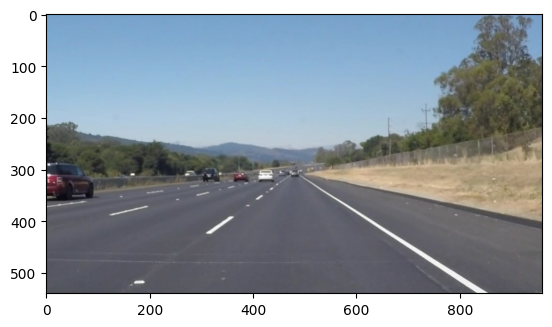

In [ ]:
# 화각과 높이가 다르면 다른 영상이 된다.
# reading in an image
image = mpimg.imread('ML_CV_Teaching/lane_detection/test_images/solidWhiteRight.jpg')

# printing out some stats and plotting
print('This image is:', type(image), 'with dimensions:', image.shape)   #shape는 (y크기, x크기, 채널수)
plt.imshow(image)

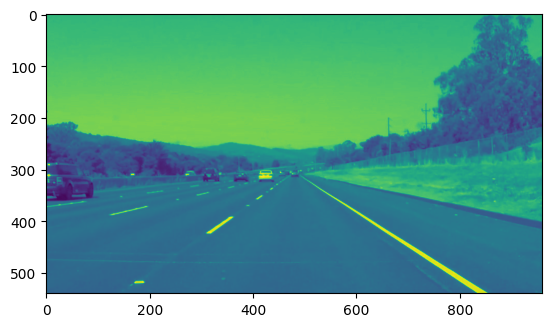

In [ ]:
imshape = image.shape

#Convert to grayscale
grayscaleImage = lp.grayscale(image)
# 이건 그냥 한 채널으로만 맞춘거고 다른 채널은 0이지만 살아는 있다.
# 그래사 cmap = 'gary'  해줘야함
plt.imshow(grayscaleImage)

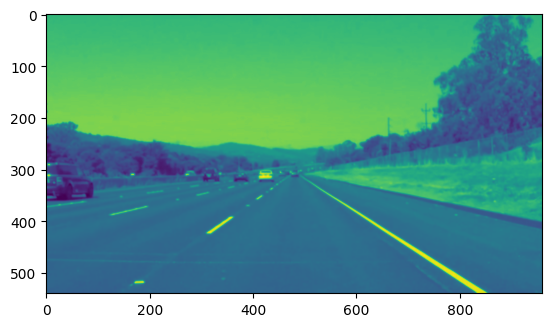

In [ ]:
#Apply gaussian blur
# 가우시안 분포를 처리해서 블러처리함
# 약간 흐릿하게 해서 잡음 처리
gaussianImage = lp.gaussian_blur(grayscaleImage, 5)
plt.imshow(gaussianImage)

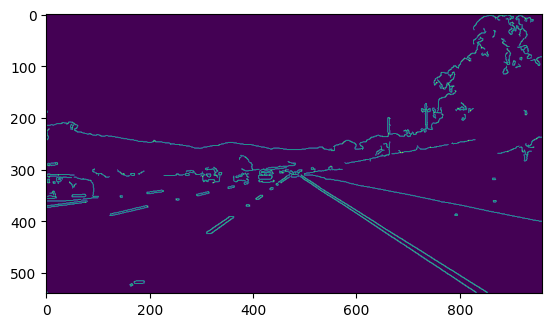

In [ ]:
# Find the edges in the image
# 윤과선 검출
cannyImage = lp.canny(gaussianImage, 50, 150)
plt.imshow(cannyImage)

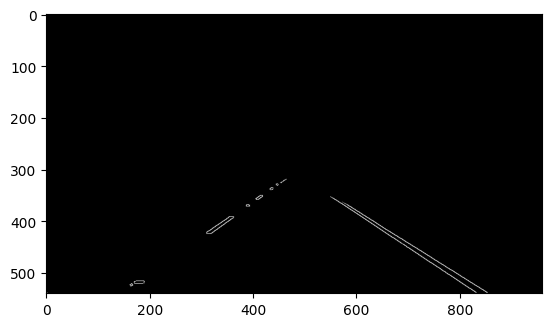

In [ ]:
# Limit to a region of interest, in this case the lanes.

# np.array([[(0, imshape[0]), (465, 320), (475, 320), (imshape[1], imshape[0])]], dtype=np.int32)
# 가운데를 기준으로 알아서 뽑음
roiMask= lp.gen_roi_mask(imshape)

#Only the required edges are displayed and rest is set to black
edgeMask = lp.region_of_interest(cannyImage, roiMask)

edgeMaskImage = cv2.cvtColor(edgeMask, cv2.COLOR_GRAY2RGB)
plt.imshow(edgeMaskImage)

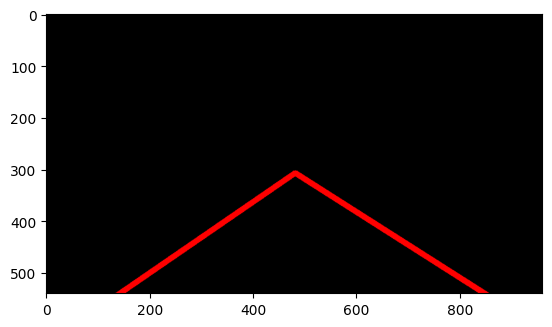

In [ ]:
#Gough lines transform to detect straight lines and then highlight the detected line
#rho = 2
#theta = np.pi/180
#threshold = 15
#min_line_length = 40
#max_line_gap = 20

# 이어진걸 확인
linesImage = lp.hough_lines(edgeMask)
plt.imshow(linesImage)

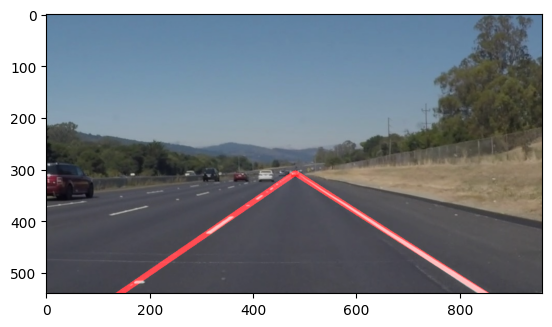

In [ ]:
# 잘 된건지 확인
marked_img = cv2.addWeighted(image, 0.8, linesImage, 1, 0)
plt.imshow(marked_img)

In [ ]:
def process_image(image):
    imshape = image.shape
    #Convert to grayscale
    grayscaleImage = lp.grayscale(image)

    #Apply gaussian blur
    gaussianImage = lp.gaussian_blur(grayscaleImage, 5)

    # Find the edges in the image
    cannyImage = lp.canny(gaussianImage, 50, 150)

    #Limit to a region of interest, in this case the lanes
    roiMask= np.array([[(0, imshape[0]), (465, 320), (475, 320), (imshape[1], imshape[0])]], dtype=np.int32)
    edgeMask = lp.region_of_interest(cannyImage, roiMask)

    #Only the required edges are displayed and rest is set to black
    edgeMaskImage = cv2.cvtColor(edgeMask, cv2.COLOR_GRAY2RGB)

    #Hough lines
    rho = 2
    theta = np.pi/180
    threshold = 15
    min_line_length = 40
    max_line_gap = 20
    linesImage = lp.hough_lines(edgeMask, rho, theta, threshold, min_line_length, max_line_gap)

    result = cv2.addWeighted(image, 0.8, linesImage, 1, 0)
    return result

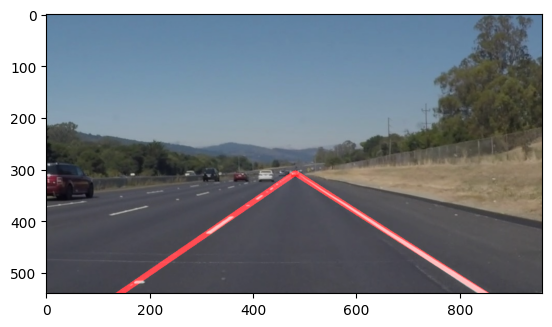

In [ ]:
# Test this function
marked_img = lp.process_image(image)
plt.imshow(marked_img)

In [ ]:
#Add a few more libraries
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
#Load first video
clip1_path = 'ML_CV_Teaching/lane_detection/test_videos/solidWhiteRight.mp4'
clip1 = VideoFileClip(clip1_path)
lp.playvideo(clip1_path)
clip1.ipython_display(clip1)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
#precess the first video

#set output file name
clip1_output = 'clip1_out.mp4'

# use "process_image" function to process very frame in clip1
clip1_marked = clip1.fl_image(lp.process_image)

#save the marked clip1
%time clip1_marked.write_videofile(clip1_output, audio=False)

# show marked clip1
# clip1.ipython_display(clip1_marked)
lp.playvideo(clip1_output)

Moviepy - Building video clip1_out.mp4.
Moviepy - Writing video clip1_out.mp4



Moviepy - Done !
Moviepy - video ready clip1_out.mp4
CPU times: user 2.39 s, sys: 454 ms, total: 2.85 s
Wall time: 12.5 s


In [ ]:
#Load the second Video

clip2_path = 'ML_CV_Teaching/lane_detection/test_videos/solidYellowLeft.mp4'
clip2 = VideoFileClip(clip2_path)
lp.playvideo(clip2_path)

In [23]:
clip2_path = 'ML_CV_Teaching/lane_detection/test_videos/solidYellowLeft.mp4'
clip1 = VideoFileClip(clip2_path)
lp.playvideo(clip2_path)
# clip1.ipython_display(clip2)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [24]:
#precess the first video

#set output file name
clip2_output = 'clip2_out.mp4'

# use "process_image" function to process very frame in clip1
clip2_marked = clip1.fl_image(lp.process_image)

#save the marked clip1
%time clip2_marked.write_videofile(clip2_output, audio=False)

# show marked clip1
# clip2.ipython_display(clip1_marked)
lp.playvideo(clip2_output)

Moviepy - Building video clip2_out.mp4.
Moviepy - Writing video clip2_out.mp4



t:   1%|          | 6/681 [00:00<00:12, 53.71it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

  ret = ret.dtype.type(ret / rcount)

  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,

  arrmean = um.true_divide(arrmean, div, out=arrmean,

  ret = ret.dtype.type(ret / rcount)



Moviepy - Done !
Moviepy - video ready clip2_out.mp4
CPU times: user 8.21 s, sys: 1.51 s, total: 9.72 s
Wall time: 39 s
